In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
import pandas as pd
from sklearn.base import BaseEstimator
from sklearn.model_selection import cross_val_score

In [17]:
POI_FILENAME = "data/poi-paris.pkl"
parismap = mpimg.imread('data/paris-48.806-2.23--48.916-2.48.jpg')
# coordonnees GPS de la carte
xmin, xmax = 2.23, 2.48  # coord_x min et max
ymin, ymax = 48.806, 48.916  # coord_y min et max
coords = [xmin, xmax, ymin, ymax]

In [18]:
# .py file 

def get_density2D(f, data, steps=100):
    """ Calcule la densité en chaque case d'une grille steps x steps dont les bornes sont calculées à partir du min/max de data. Renvoie la grille estimée et la discrétisation sur chaque axe.
    """
    xmin, xmax = data[:, 0].min(), data[:, 0].max()
    ymin, ymax = data[:, 1].min(), data[:, 1].max()
    xlin, ylin = np.linspace(xmin, xmax, steps), np.linspace(ymin, ymax, steps)
    xx, yy = np.meshgrid(xlin, ylin)
    grid = np.c_[xx.ravel(), yy.ravel()]
    res = f.predict(grid).reshape(steps, steps)
    return res, xlin, ylin


def show_density(f, data, steps=100, log=False):
    """
    Dessine la densité f et ses courbes de niveau sur une grille 2D calculée à partir de data, avec un pas de discrétisation de steps. Le paramètre log permet d'afficher la log densité plutôt que la densité brute
    """
    res, xlin, ylin = get_density2D(f, data, steps)
    xx, yy = np.meshgrid(xlin, ylin)
    plt.figure()
    show_img()
    if log:
        res = np.log(res+1e-10)
    plt.scatter(data[:, 0], data[:, 1], alpha=0.8, s=3)
    show_img(res)
    plt.colorbar()
    plt.contour(xx, yy, res, 20)


def show_img(img=parismap):
    """ Affiche une matrice ou une image selon les coordonnées de la carte de Paris.
    """
    origin = "lower" if len(img.shape) == 2 else "upper"
    alpha = 0.3 if len(img.shape) == 2 else 1.
    plt.imshow(img, extent=coords, aspect=1.5, origin=origin, alpha=alpha)
    # extent pour controler l'echelle du plan


def load_poi(typepoi, fn=POI_FILENAME):
    """ Dictionaire POI, clé : type de POI, valeur : dictionnaire des POIs de ce type : (id_POI, [coordonnées, note, nom, type, prix])

    Liste des POIs : furniture_store, laundry, bakery, cafe, home_goods_store, 
    clothing_store, atm, lodging, night_club, convenience_store, restaurant, bar
    """
    poidata = pickle.load(open(fn, "rb"))
    data = np.array([[v[1][0][1], v[1][0][0]]
                    for v in sorted(poidata[typepoi].items())])
    note = np.array([v[1][1] for v in sorted(poidata[typepoi].items())])
    return data, note


In [41]:
# .py file

class Density(BaseEstimator):
    def __init__(self) -> None:
        super().__init__()
    
    def fit(self, data):
        pass

    def predict(self, data):
        pass

    def score(self, data):
        density = self.predict(data)
        return np.log( np.where(density == 0, 1e-10, density) ).sum()
    
class Histogramme(Density):
    def __init__(self, steps=10):
        # Appelle le constructeur de la classe parente Density
        Density.__init__(self)
        # Initialise le nombre de steps pour l'histogramme
        self.steps = steps
        # Initialise les attributs density et bins
        self.density = None
        self.bins = None

    def fit(self, x):
        """
        Apprend l'histogramme de la densité sur x
        """
        # Calcule l'histogramme multidimensionnel avec le nombre de bins spécifié
        self.density, self.bins = np.histogramdd(x, bins=[self.steps]*x.shape[-1], density=True)

    def predict(self, x):
        """
        Retourne la densité associée à chaque point de x
        """
        def to_bin(x):
            """
            Calcule les indices de x à partir du pas de discrétisation et des bornes min et max de l'histogramme
            """
            # Récupère les bornes de l'histogramme
            bins_stack = np.stack(self.bins, axis=1)
            # Exception pour les points représentant les bornes de l'Histogramme,
            # On les augmente un peu pour les faire rentrer
            # Évite un test dans la boucle
            bins_stack[-1] += 1e-10

            result = []
            xi_dim = x.shape[-1]
            for xi in x:
                tmp = []
                for i in range(xi_dim):
                    bin_i = bins_stack[..., i]
                    xi_i = xi[..., i]
                    if bin_i[-1] < xi_i or xi_i < bin_i[0]:
                        tmp.append(None)
                    else:
                        where = np.nonzero(bin_i <= xi_i)[-1]
                        tmp.append(where[-1])
                result.append(tuple(tmp))
            return result

        prediction = []
        for i, coords in enumerate(to_bin(x)):
            # Vérifie si des coordonnées sont manquantes (None) dans les bins
            if coords.count(None) != 0:
                prediction.append(0)
            else:
                # Ajoute la densité associée aux coordonnées prédites
                prediction.append(self.density[coords])
        return np.array(prediction)
    

# Methode par Histogramme

In [42]:
poi_list = ["furniture_store", "laundry", "bakery", "cafe", "home_goods_store", "clothing_store", "atm", "lodging", "night_club", "convenience_store", "restaurant", "bar"]

geo_mat = []
notes = []
for poi in poi_list:
    x, y = load_poi(poi)
    geo_mat.append(x)
    notes.append(y)

C:\Users\Kadem\AppData\Local\Temp\ipykernel_112496\1167133527.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


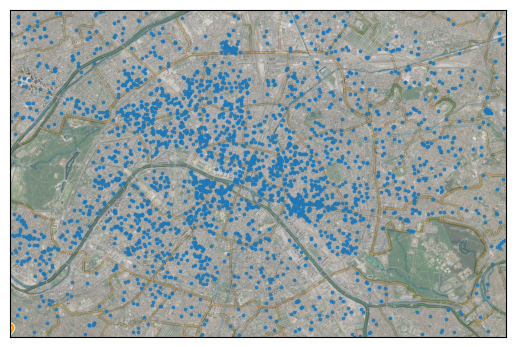

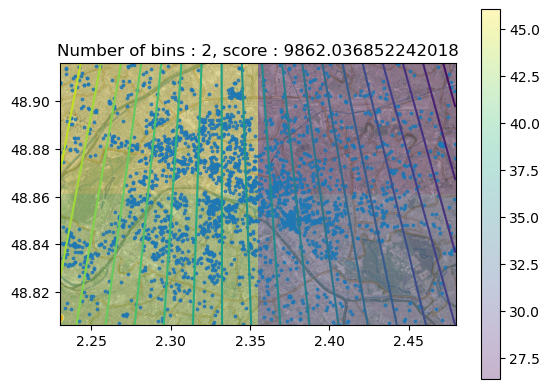

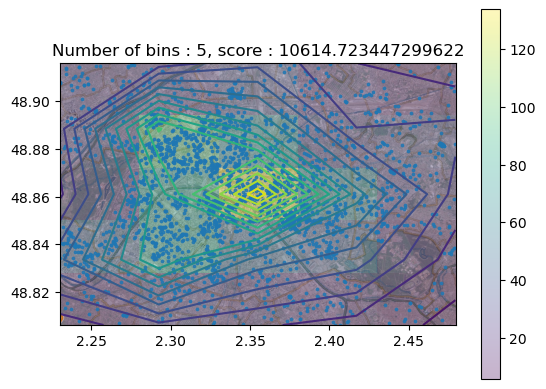

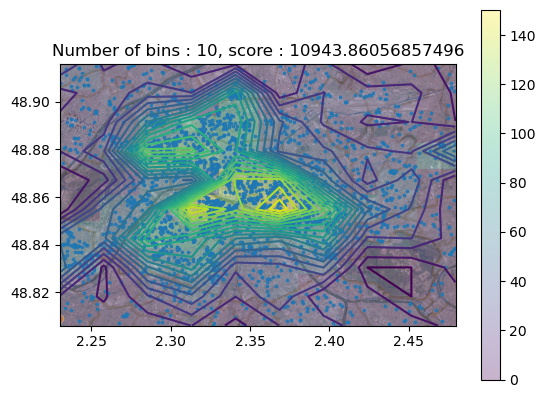

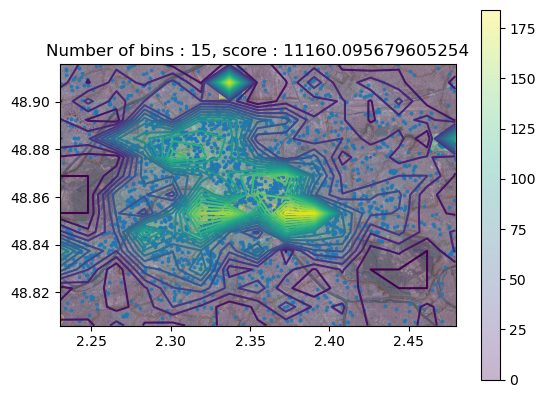

...

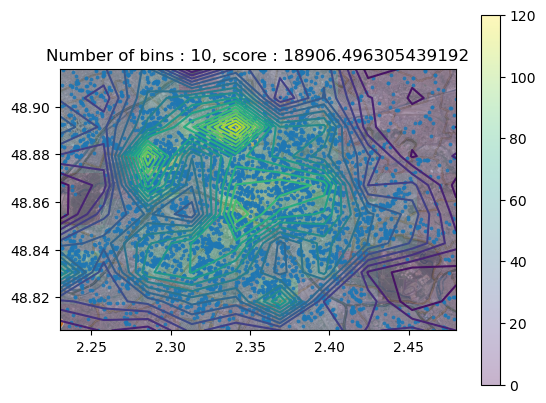

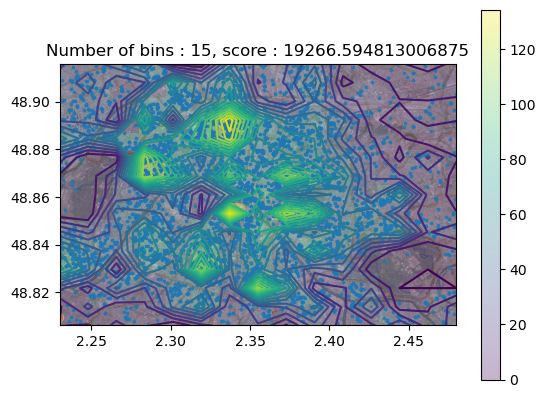

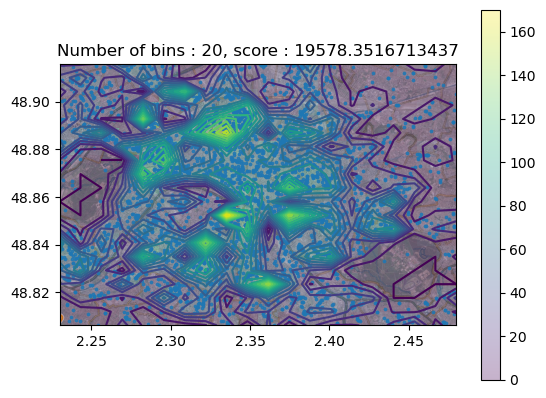

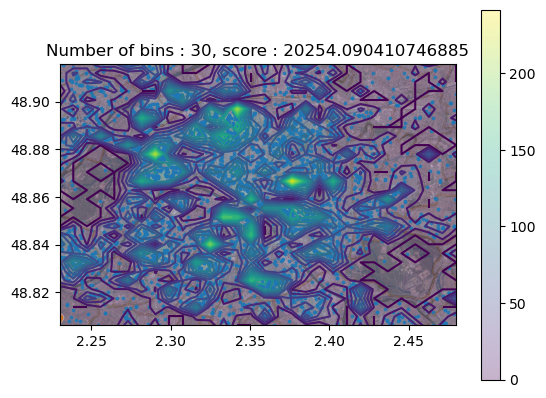

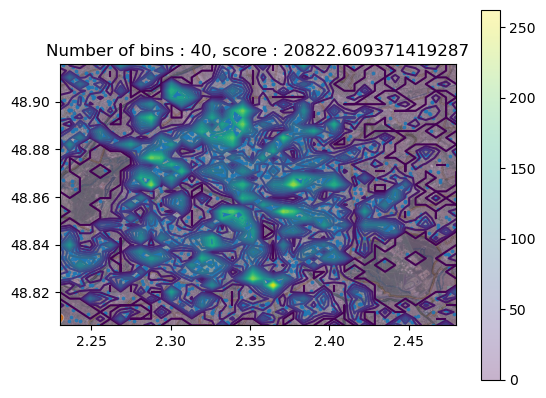

In [43]:
for geo in geo_mat:
    show_img()

    plt.scatter(geo[:,0],geo[:,1],alpha=0.8,s=3)
    plt.xticks([])
    plt.yticks([])

    for steps in [2, 5, 10, 15, 20, 30, 40]:
        nc_hist = Histogramme(steps)
        nc_hist.fit(geo)
        nc_hist.predict(geo)
        show_density(nc_hist, geo, steps)
        plt.gca().set_title(f'Number of bins : {steps}, score : {nc_hist.score(geo)}')

## Validation croisé

furniture_store
Meilleurs steps : 17
laundry
Meilleurs steps : 17
bakery
Meilleurs steps : 17
cafe
Meilleurs steps : 17
home_goods_store
Meilleurs steps : 17
clothing_store
Meilleurs steps : 17
atm
Meilleurs steps : 17
lodging
Meilleurs steps : 17
night_club
Meilleurs steps : 17
convenience_store
Meilleurs steps : 17
restaurant
Meilleurs steps : 17
bar
Meilleurs steps : 17


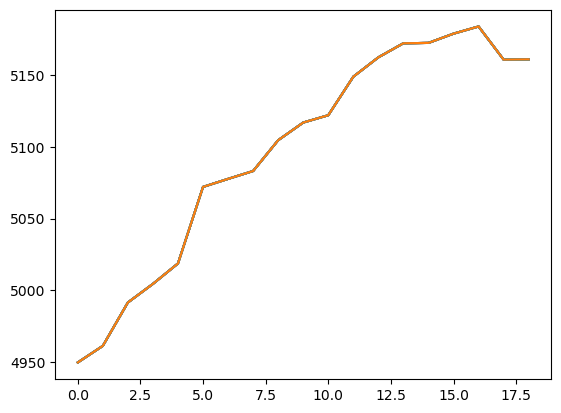

In [21]:
for poi in poi_list:
    mean_list = []
    steps_list = []
    for steps in range(1, 20):
        geo_mat, notes = load_poi("restaurant")
        score_list = cross_val_score(Histogramme(steps=steps), geo_mat)
        mean_list.append(np.mean(score_list))
        steps_list.append(steps)
    print(poi)
    print("Meilleurs steps :", steps_list[np.argmax(mean_list)])
    plt.plot(mean_list)

# Méthodes à noyaux

In [35]:
def kernel_uniform(x):
    bool_list = (np.abs(x) < 0.5).all(axis=1)
    return np.where(bool_list, 1, 0)

In [36]:
test_x = np.array(
    [[0.25, 0.2, 0.45],
    [0.25, 0.2, 0.55],
    [12991.70085, 271411.03284, 0.4],
    [12991.619831, 271411.321743, 0.4],
    [12991.763074, 271411.541286, 0.4]],
)
kernel_uniform(test_x)

array([1, 0, 0, 0, 0])

In [37]:
def kernel_gaussian(x):
    d = x.shape[-1]
    return np.exp(-0.5 * np.linalg.norm(x, axis=1)**2) * (2*np.pi)**(-d/2) 

In [38]:
kernel_gaussian(test_x)

array([0.05451303, 0.05185439, 0.        , 0.        , 0.        ])

In [39]:
class KernelDensity(Density):
    def __init__(self, kernel=None, sigma=0.1):
        Density.__init__(self)
        self.kernel = kernel
        self.sigma = sigma

    def fit(self, x):
        self.x = x

    def predict(self, data):
        # retourne la densité associée à chaque point de data
        n, d = self.x.shape
        l = []
        for x_i in data:
            x_i_stacked = np.vstack([x_i]*n)
            sum_value = self.kernel((x_i_stacked - self.x)/self.sigma).sum()
            l.append(sum_value / (n*self.sigma**d))
        return np.array(l)

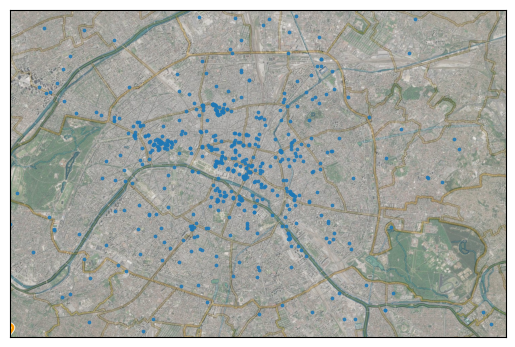

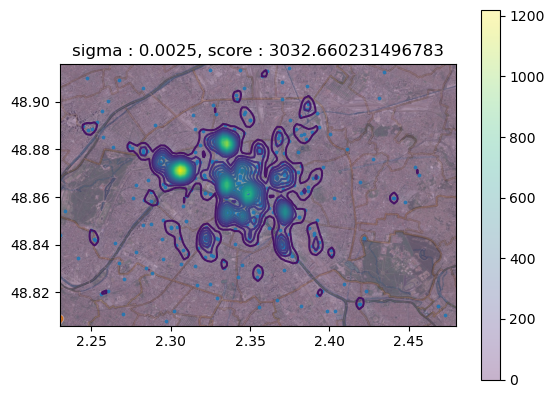

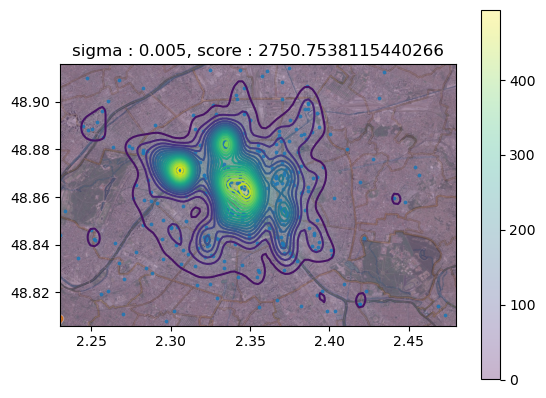

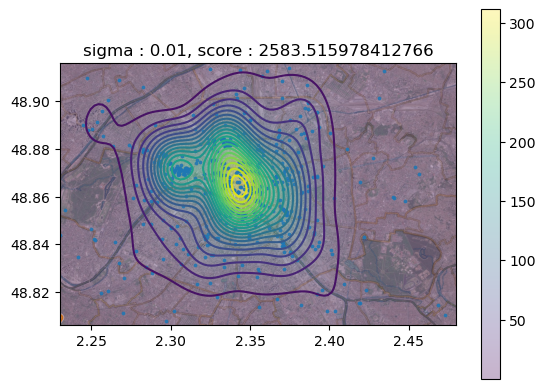

In [40]:
geo_mat, notes = load_poi("night_club")

# Affiche la carte de Paris
show_img()
# Affiche les POIs
plt.scatter(geo_mat[:,0],geo_mat[:,1],alpha=0.8,s=3)
plt.xticks([])
plt.yticks([])

for sigma in [0.0025, 0.005, 0.01]:
    nc_kernelDensity = KernelDensity(kernel=kernel_gaussian, sigma=sigma)
    nc_kernelDensity.fit(geo_mat)
    show_density(nc_kernelDensity, geo_mat)
    plt.gca().set_title(f'sigma : {sigma}, score : {nc_kernelDensity.score(geo_mat)}')